### Read csv file with temperature data collected by Dungeness hatchery and check correlation to state data

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import datetime
import matplotlib.dates as mdates
from urllib.request import urlopen
from bs4 import BeautifulSoup
import io


In [3]:
year = "2008"
df = pd.read_excel(
   io="/home/maria/Documents/data/pied_piper/TempallDUNG.xls",
   sheet_name =year,
    header = [0]
)

In [4]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df)

,Date Time,Deg ©,Deg (F),Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9
0,2008-02-13 08:00:00,2.63,36.734,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2008-02-13 09:00:00,3.26,37.868,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2008-02-13 10:00:00,5.43,41.774,NaN,Trapping Started 2/13/2008 @ 1530,NaN,NaN,NaN,NaN,NaN
3,2008-02-13 11:00:00,7.58,45.644,NaN,Trapping ended 8/12/2008 @ 0930,NaN,NaN,NaN,NaN,NaN
4,2008-02-13 12:00:00,9.42,48.956,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2008-02-13 13:00:00,11.12,52.016,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2008-02-13 14:00:00,12.82,55.076,NaN,Data logger likely deployment date and time,NaN,NaN,NaN,NaN,2/13/2008 @0800
7,2008-02-13 15:00:00,14.04,57.272,NaN,Data logger likely removal date and time.,NaN,NaN,NaN,NaN,8/12/2008 @ 1100
8,2008-02-13 16:00:00,13.74,56.732,NaN,No date \time records found for data logger d...,NaN,NaN,NaN,NaN,NaN
9,2008-02-13 17:00:00,13.43,56.174,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
print(df.columns)
df_year = df.rename(columns={'Date Time': "date_time",
                        'Deg ©': "temp",
                        'Deg (F)': "temp_F"})
print(df_year.columns)

Index(['Date Time', 'Deg ©', 'Deg (F)', 'Unnamed: 3', 'Unnamed: 4',
       'Unnamed: 5', 'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9'],
      dtype='object')
Index(['date_time', 'temp', 'temp_F', 'Unnamed: 3', 'Unnamed: 4', 'Unnamed: 5',
       'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9'],
      dtype='object')


#### Comparing WA state data with hatchery data

In [12]:
#getting temperature data
#reading html data
year = "2008"
url = "https://apps.ecology.wa.gov/ContinuousFlowAndWQ/StationData/Prod/18A050/18A050_" + year + "_WTM_FM.TXT"
html = urlopen(url).read()
soup = BeautifulSoup(html, features="html.parser")

# kill all script and style elements
for script in soup(["script", "style"]):
    script.extract()    # rip it out

# get text
text = soup.get_text()


text = text[522:-72]


df = pd.read_csv(io.StringIO(text), sep='\s+', header = None, names = ["date", "time", "temp", "quality"])

# df = df.iloc[:-2] #removing last two rows that do not contain data
df['midpoint'] =  pd.to_datetime(df['date'] + ' ' + df['time'])

In [15]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df)
    

,date,time,temp,quality,midpoint
0,10/01/2007,00:00,10.1,140.0,2007-10-01 00:00:00
1,10/01/2007,00:15,10.0,140.0,2007-10-01 00:15:00
2,10/01/2007,00:30,10.0,140.0,2007-10-01 00:30:00
3,10/01/2007,00:45,9.9,140.0,2007-10-01 00:45:00
4,10/01/2007,01:00,9.9,140.0,2007-10-01 01:00:00
5,10/01/2007,01:15,9.9,140.0,2007-10-01 01:15:00
6,10/01/2007,01:30,9.8,140.0,2007-10-01 01:30:00
7,10/01/2007,01:45,9.8,140.0,2007-10-01 01:45:00
8,10/01/2007,02:00,9.8,140.0,2007-10-01 02:00:00
9,10/01/2007,02:15,9.7,140.0,2007-10-01 02:15:00


In [16]:
df = df[df['quality'] == 140]

In [17]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df)

,date,time,temp,quality,midpoint
0,10/01/2007,00:00,10.1,140.0,2007-10-01 00:00:00
1,10/01/2007,00:15,10.0,140.0,2007-10-01 00:15:00
2,10/01/2007,00:30,10.0,140.0,2007-10-01 00:30:00
3,10/01/2007,00:45,9.9,140.0,2007-10-01 00:45:00
4,10/01/2007,01:00,9.9,140.0,2007-10-01 01:00:00
5,10/01/2007,01:15,9.9,140.0,2007-10-01 01:15:00
6,10/01/2007,01:30,9.8,140.0,2007-10-01 01:30:00
7,10/01/2007,01:45,9.8,140.0,2007-10-01 01:45:00
8,10/01/2007,02:00,9.8,140.0,2007-10-01 02:00:00
9,10/01/2007,02:15,9.7,140.0,2007-10-01 02:15:00


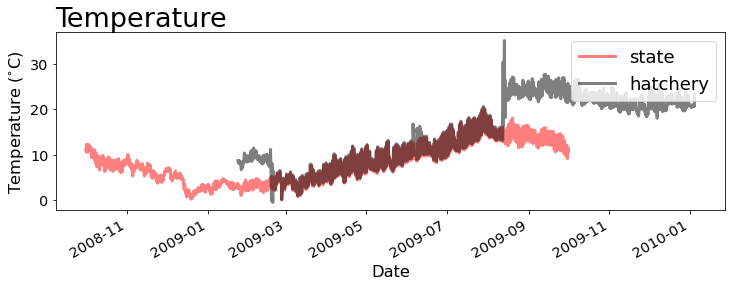

In [30]:
#plot temperature from state data and hatchery data
fs = 18
lw = 3
transparency = 0.5
plt.close('all') # always start by cleaning up
fig = plt.figure(figsize=(12,8))

ax1 = fig.add_subplot(211)
ax1.plot(
    df['midpoint'], df['temp'], color = 'red', 
    label = 'state', alpha = 0.5, linewidth = lw)
ax1.plot(
    df_year['date_time'], df_year['temp'], color = 'black', 
    label = 'hatchery', alpha = 0.5, linewidth = lw)
plt.gcf().autofmt_xdate()
plt.xlabel('Date', size = 0.9*fs)
plt.ylabel('Temperature '+ r'($^{\circ}$C)', size = 0.9*fs)
ax1.tick_params(labelsize=.8*fs)
#ax1.set_xlim([datetime.date(2008, 2, 15), datetime.date(2008, 9, 1)])
ax1.set_title('Temperature', loc='left', fontsize = fs*1.5)
plt.legend(fontsize=fs, loc='upper right', title = '')





In [23]:
#2009
year = "2009"
df = pd.read_excel(
   io="/home/maria/Documents/data/pied_piper/TempallDUNG.xls",
   sheet_name =year,
    header = [0]
)

In [25]:
print(df.columns)
df_year = df.rename(columns={'Date Time': "date_time",
                        'Deg ©': "temp",
                        'Deg (F)': "temp_F"})
print(df_year.columns)

Index(['Date Time', 'Deg ©', 'Deg (F)', 'Unnamed: 3', 'Unnamed: 4',
       'Unnamed: 5', 'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9'],
      dtype='object')
Index(['date_time', 'temp', 'temp_F', 'Unnamed: 3', 'Unnamed: 4', 'Unnamed: 5',
       'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9'],
      dtype='object')


In [26]:
#getting temperature data
#reading html data

url = "https://apps.ecology.wa.gov/ContinuousFlowAndWQ/StationData/Prod/18A050/18A050_" + year + "_WTM_FM.TXT"
html = urlopen(url).read()
soup = BeautifulSoup(html, features="html.parser")

# kill all script and style elements
for script in soup(["script", "style"]):
    script.extract()    # rip it out

# get text
text = soup.get_text()



text = text[522:-50]


df = pd.read_csv(io.StringIO(text), sep='\s+', header = None, names = ["date", "time", "temp", "quality"])

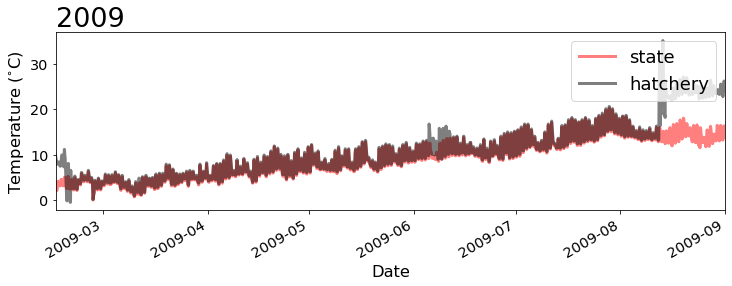

In [29]:
df['midpoint'] =  pd.to_datetime(df['date'] + ' ' + df['time'])
#plot temperature from state data and hatchery data
fs = 18
lw = 3
transparency = 0.5
plt.close('all') # always start by cleaning up
fig = plt.figure(figsize=(12,8))

ax1 = fig.add_subplot(211)
ax1.plot(
    df['midpoint'], df['temp'], color = 'red', 
    label = 'state', alpha = 0.5, linewidth = lw)
ax1.plot(
    df_year['date_time'], df_year['temp'], color = 'black', 
    label = 'hatchery', alpha = 0.5, linewidth = lw)
plt.gcf().autofmt_xdate()
plt.xlabel('Date', size = 0.9*fs)
plt.ylabel('Temperature '+ r'($^{\circ}$C)', size = 0.9*fs)
ax1.tick_params(labelsize=.8*fs)
ax1.set_xlim([datetime.date(2009, 2, 15), datetime.date(2009, 9, 1)])
ax1.set_title('2009', loc='left', fontsize = fs*1.5)
plt.legend(fontsize=fs, loc='upper right', title = '')





In [42]:
for i in range(1,len(df_year)):
#    df_year.loc[i-1, 'difference'] = df_year.loc[i-1, 'temp']  - df_year.loc[i, 'temp']
     if (df_year.loc[i-1, 'temp'] < df_year.loc[i, 'temp'] - 2):
         print(df_year.loc[i])


date_time     2009-02-19 11:00:00
temp                         3.88
temp_F                     38.984
Unnamed: 3                    NaN
Unnamed: 4                    NaN
Unnamed: 5                    NaN
Unnamed: 6                    NaN
Unnamed: 7                    NaN
Unnamed: 8                    NaN
Unnamed: 9                    NaN
difference                  -2.63
Name: 635, dtype: object
date_time     2009-02-19 12:00:00
temp                         6.51
temp_F                     43.718
Unnamed: 3                    NaN
Unnamed: 4                    NaN
Unnamed: 5                    NaN
Unnamed: 6                    NaN
Unnamed: 7                    NaN
Unnamed: 8                    NaN
Unnamed: 9                    NaN
difference                   2.63
Name: 636, dtype: object
date_time     2009-06-05 09:00:00
temp                         14.2
temp_F                      57.56
Unnamed: 3                    NaN
Unnamed: 4                    NaN
Unnamed: 5                    Na

In [41]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df_year)

,date_time,temp,temp_F,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,difference
0,2009-01-24 00:00:00,8.66,47.588,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.15
1,2009-01-24 01:00:00,8.51,47.318,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00
2,2009-01-24 02:00:00,8.51,47.318,NaN,Trapping Started 2/19/2009@ 1330,NaN,NaN,NaN,NaN,NaN,0.16
3,2009-01-24 03:00:00,8.35,47.030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00
4,2009-01-24 04:00:00,8.35,47.030,NaN,Trapping ended 8/12/2009 @0745,NaN,NaN,NaN,NaN,NaN,0.00
5,2009-01-24 05:00:00,8.35,47.030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.15
6,2009-01-24 06:00:00,8.20,46.760,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00
7,2009-01-24 07:00:00,8.20,46.760,NaN,Data logger likely deployment date and time,NaN,NaN,NaN,NaN,1/24/2009 @ 0000,0.00
8,2009-01-24 08:00:00,8.20,46.760,NaN,Data logger likely removal date and time.,NaN,NaN,NaN,NaN,8/12/2009 @1200,0.16
9,2009-01-24 09:00:00,8.04,46.472,NaN,No date \time records found for data logger d...,NaN,NaN,NaN,NaN,NaN,0.00
